<a href="https://colab.research.google.com/github/yuseongil034/yuseongil/blob/main/0709_opencv_car_detection2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

세미 엣지

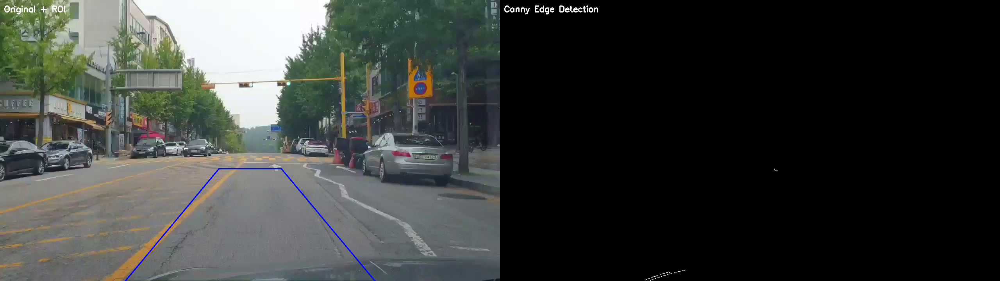

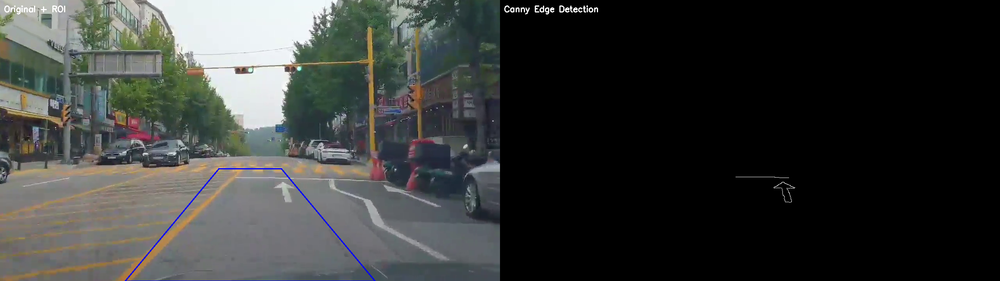

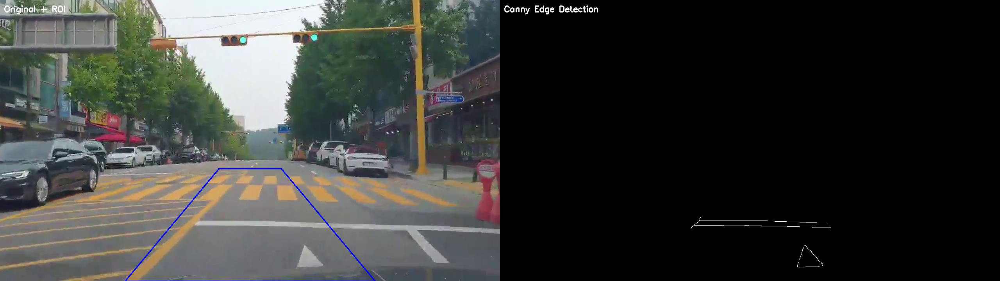

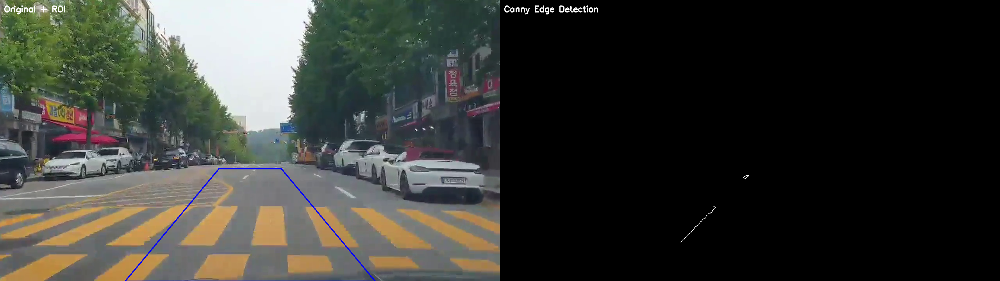

차선 검출 처리 완료!


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# 동영상 파일 열기
cap = cv2.VideoCapture('/content/sample_data/around5.mp4')  # 파일 경로 수정 필요

# 옵션 1: 중앙 차선 (기본값)
def create_lane_roi_center(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    # 중앙 차선 - 사다리꼴 모양
    roi_points = np.array([
        [width//4, height],        # 왼쪽 아래
        [width*3//8, height//2],   # 왼쪽 위
        [width*5//8, height//2],   # 오른쪽 위
        [width*3//4, height]       # 오른쪽 아래
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 옵션 2: 왼쪽 차선 (좌측 주행)
def create_lane_roi_left(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    # 왼쪽 차선 - 사다리꼴 모양
    roi_points = np.array([
        [0, height],               # 왼쪽 아래
        [width//5, height//2],     # 왼쪽 위
        [width*2//5, height//2],   # 오른쪽 위
        [width//2, height]         # 오른쪽 아래
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 옵션 3: 오른쪽 차선 (우측 주행)
def create_lane_roi_right(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    # 오른쪽 차선 - 사다리꼴 모양
    roi_points = np.array([
        [width//2, height],        # 왼쪽 아래
        [width*3//5, height//2],   # 왼쪽 위
        [width*4//5, height//2],   # 오른쪽 위
        [width, height]            # 오른쪽 아래
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 옵션 4: 더 넓은 ROI (양쪽 차선 모두)
def create_lane_roi_wide(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    # 넓은 ROI - 사다리꼴 모양
    roi_points = np.array([
        [width//8, height],        # 왼쪽 아래
        [width*3//8, height//2],   # 왼쪽 위
        [width*5//8, height//2],   # 오른쪽 위
        [width*7//8, height]       # 오른쪽 아래
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 옵션 5: 실제 차선에 맞춘 ROI (이미지 기반 조정)
def create_lane_roi_custom(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    # 실제 차선에 맞춘 좌표 (이미지 분석 결과)
    left_bottom = [width//6, height]          # 왼쪽 아래 (더 넓게)
    left_top = [width*2//5, height*3//5]      # 왼쪽 위 (더 아래쪽으로)
    right_top = [width*3//5, height*3//5]     # 오른쪽 위 (더 아래쪽으로)
    right_bottom = [width*5//6, height]       # 오른쪽 아래 (더 넓게)

    roi_points = np.array([
        left_bottom,
        left_top,
        right_top,
        right_bottom
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 옵션 8: 더 오른쪽으로 조정된 ROI (최종 조정)
def create_lane_roi_more_right(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    # 더 오른쪽으로 조정된 ROI 좌표
    roi_points = np.array([
        [width*3//8, height],        # 왼쪽 아래 (더 오른쪽으로)
        [width//2, height*3//5],     # 왼쪽 위 (더 오른쪽으로)
        [width*5//8, height*3//5],   # 오른쪽 위 (더 오른쪽으로)
        [width*7//8, height]         # 오른쪽 아래 (더 오른쪽으로)
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 여기서 사용할 ROI 함수를 선택하세요
# 옵션 1: 중앙 차선 (기본값)
# 옵션 2: 왼쪽 차선
# 옵션 3: 오른쪽 차선
# 옵션 4: 넓은 ROI
# 옵션 5: 실제 차선에 맞춘 ROI
# 옵션 6: 더 넓은 실제 차선 ROI (이전 버전)
# 옵션 7: 오른쪽으로 조정된 ROI (추천)

# 사용할 ROI 함수 선택 (이 부분을 수정하세요)
selected_roi_function = create_lane_roi_adjusted  # 오른쪽으로 조정된 버전

frame_count = 0
while True:
    ret, frame = cap.read()
    if not ret:
        break

    # 그레이스케일 변환
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # 가우시안 블러로 노이즈 제거
    blur = cv2.GaussianBlur(gray, (5, 5), 0)

    # Canny 에지 검출
    edges = cv2.Canny(blur, 50, 150)

    # 선택한 ROI 적용
    roi_mask, roi_points = selected_roi_function(frame)
    masked_edges = cv2.bitwise_and(edges, roi_mask)

    # 결과 프레임 복사
    result_frame = frame.copy()

    # ROI 영역을 시각화 (사다리꼴 모양 표시)
    cv2.polylines(result_frame, [roi_points], True, (255, 0, 0), 2)  # 파란색 사다리꼴

    # 매 30프레임마다 결과 출력
    if frame_count % 30 == 0:
        # 영어 라벨 추가
        cv2.putText(result_frame, "Original + ROI", (10, 30),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 255, 255), 2)

        edge_display = cv2.cvtColor(masked_edges, cv2.COLOR_GRAY2BGR)
        cv2.putText(edge_display, "Canny Edge Detection", (10, 30),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 255, 255), 2)

        # 결과를 나란히 표시 (원본+ROI + 에지검출)
        combined = np.hstack((result_frame, edge_display))
        cv2_imshow(combined)

    frame_count += 1

    # 100프레임 후 종료 (테스트용)
    if frame_count > 100:
        break

# 자원 해제
cap.release()
print("차선 검출 처리 완료!")

# 사용 방법:
# 1. 코드를 실행하여 현재 ROI가 적절한지 확인
# 2. 만족스럽지 않으면 selected_roi_function을 다른 옵션으로 변경
# 3. 더 정확한 조정이 필요하면 create_lane_roi_custom 함수의 좌표값을 수정

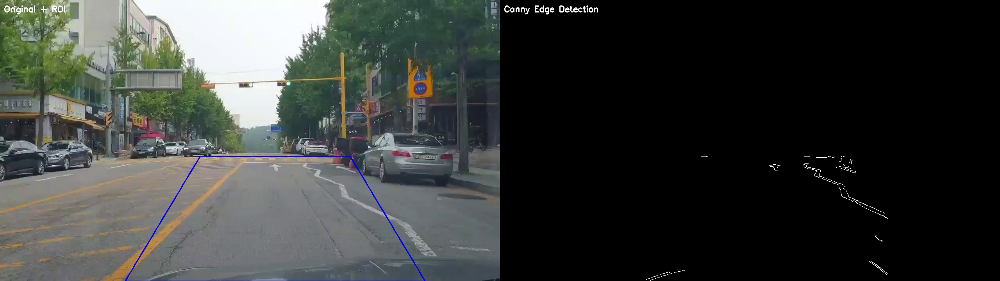

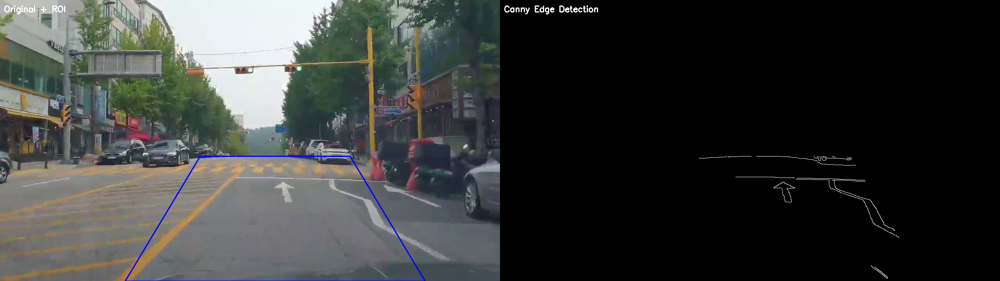

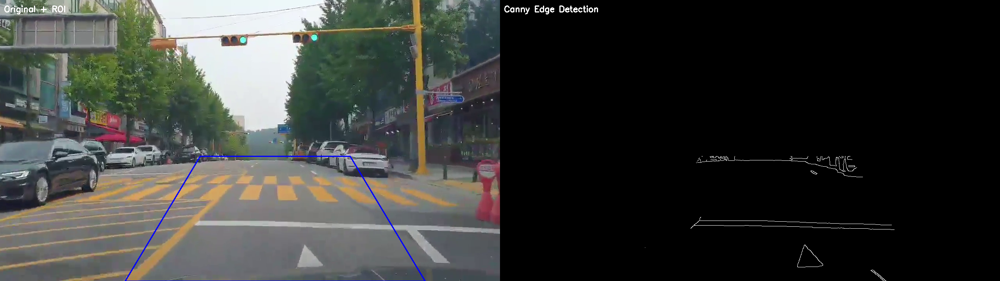

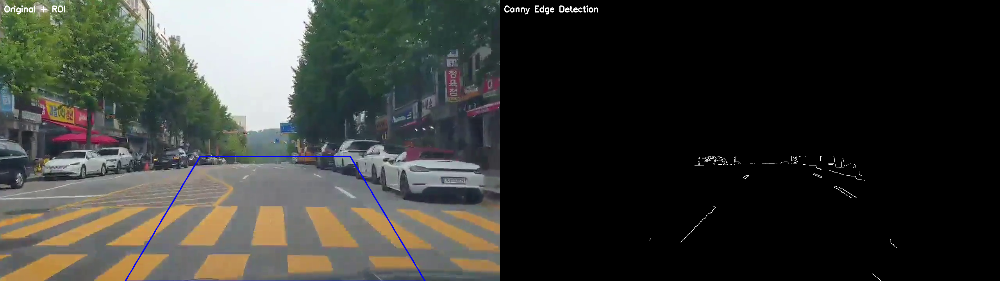

차선 검출 처리 완료!


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# 동영상 파일 열기
cap = cv2.VideoCapture('/content/sample_data/around5.mp4')  # 파일 경로 수정 필요

# 옵션 1: 중앙 차선 (기본값)
def create_lane_roi_center(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    # 중앙 차선 - 사다리꼴 모양
    roi_points = np.array([
        [width//4, height],        # 왼쪽 아래
        [width*3//8, height//2],   # 왼쪽 위
        [width*5//8, height//2],   # 오른쪽 위
        [width*3//4, height]       # 오른쪽 아래
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 옵션 2: 왼쪽 차선 (좌측 주행)
def create_lane_roi_left(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    # 왼쪽 차선 - 사다리꼴 모양
    roi_points = np.array([
        [0, height],               # 왼쪽 아래
        [width//5, height//2],     # 왼쪽 위
        [width*2//5, height//2],   # 오른쪽 위
        [width//2, height]         # 오른쪽 아래
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 옵션 3: 오른쪽 차선 (우측 주행)
def create_lane_roi_right(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    # 오른쪽 차선 - 사다리꼴 모양
    roi_points = np.array([
        [width//2, height],        # 왼쪽 아래
        [width*3//5, height//2],   # 왼쪽 위
        [width*4//5, height//2],   # 오른쪽 위
        [width, height]            # 오른쪽 아래
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 옵션 4: 더 넓은 ROI (양쪽 차선 모두)
def create_lane_roi_wide(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    # 넓은 ROI - 사다리꼴 모양
    roi_points = np.array([
        [width//8, height],        # 왼쪽 아래
        [width*3//8, height//2],   # 왼쪽 위
        [width*5//8, height//2],   # 오른쪽 위
        [width*7//8, height]       # 오른쪽 아래
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 옵션 5: 실제 차선에 맞춘 ROI (이미지 기반 조정)
def create_lane_roi_custom(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    # 실제 차선에 맞춘 좌표 (이미지 분석 결과)
    left_bottom = [width//6, height]          # 왼쪽 아래 (더 넓게)
    left_top = [width*2//5, height*3//5]      # 왼쪽 위 (더 아래쪽으로)
    right_top = [width*3//5, height*3//5]     # 오른쪽 위 (더 아래쪽으로)
    right_bottom = [width*5//6, height]       # 오른쪽 아래 (더 넓게)

    roi_points = np.array([
        left_bottom,
        left_top,
        right_top,
        right_bottom
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 옵션 6: 왼쪽 차선에 맞춘 조정된 ROI (새로 추가)
def create_lane_roi_left_adjusted(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    # 왼쪽 차선에 맞춘 ROI 좌표 (이미지 분석 기반)
    roi_points = np.array([
        [width//8, height],          # 왼쪽 아래 (더 왼쪽으로)
        [width*3//8, height*3//5],   # 왼쪽 위 (더 왼쪽으로)
        [width//2, height*3//5],     # 오른쪽 위 (중앙 근처)
        [width*5//8, height]         # 오른쪽 아래 (중앙 약간 오른쪽)
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 옵션 7: 오른쪽 차선에 맞춘 ROI (수정됨) - 윗변과 밑변 길이 확장
def create_lane_roi_precise_right(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    # 대칭 사다리꼴 ROI 좌표 (윗변과 밑변 길이 확장)
    bottom_left = width*25//100   # 왼쪽 아래 (25%, 더 넓게 확장)
    bottom_right = width*85//100  # 오른쪽 아래 (85%, 더 넓게 확장)
    bottom_width = bottom_right - bottom_left  # 아래쪽 너비

    # 위쪽 너비를 아래쪽 너비의 약 50%로 설정하여 더 넓은 사다리꼴 만들기
    top_width = int(bottom_width * 0.5)
    center_x = (bottom_left + bottom_right) // 2
    top_left = center_x - top_width // 2
    top_right = center_x + top_width // 2

    roi_points = np.array([
        [bottom_left, height],       # 왼쪽 아래
        [top_left, height*5//9],     # 왼쪽 위 (대칭)
        [top_right, height*5//9],    # 오른쪽 위 (대칭)
        [bottom_right, height]       # 오른쪽 아래
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 옵션 8: 더 오른쪽으로 조정된 ROI (기존 코드)
def create_lane_roi_more_right(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    # 더 오른쪽으로 조정된 ROI 좌표
    roi_points = np.array([
        [width*3//8, height],        # 왼쪽 아래 (더 오른쪽으로)
        [width//2, height*3//5],     # 왼쪽 위 (더 오른쪽으로)
        [width*5//8, height*3//5],   # 오른쪽 위 (더 오른쪽으로)
        [width*7//8, height]         # 오른쪽 아래 (더 오른쪽으로)
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 여기서 사용할 ROI 함수를 선택하세요
# 옵션 1: 중앙 차선 (기본값)
# 옵션 2: 왼쪽 차선
# 옵션 3: 오른쪽 차선
# 옵션 4: 넓은 ROI
# 옵션 5: 실제 차선에 맞춘 ROI
# 옵션 6: 왼쪽 차선에 맞춘 조정된 ROI (추천)
# 옵션 7: 오른쪽 차선에 맞춘 ROI (추천)
# 옵션 8: 더 오른쪽으로 조정된 ROI (기존)

# 사용할 ROI 함수 선택 (오른쪽 차선에 맞게 변경)
selected_roi_function = create_lane_roi_precise_right  # 오른쪽 차선 버전

frame_count = 0
while True:
    ret, frame = cap.read()
    if not ret:
        break

    # 그레이스케일 변환
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # 가우시안 블러로 노이즈 제거
    blur = cv2.GaussianBlur(gray, (5, 5), 0)

    # Canny 에지 검출
    edges = cv2.Canny(blur, 50, 150)

    # 선택한 ROI 적용
    roi_mask, roi_points = selected_roi_function(frame)
    masked_edges = cv2.bitwise_and(edges, roi_mask)

    # 결과 프레임 복사
    result_frame = frame.copy()

    # ROI 영역을 시각화 (사다리꼴 모양 표시)
    cv2.polylines(result_frame, [roi_points], True, (255, 0, 0), 2)  # 파란색 사다리꼴

    # 매 30프레임마다 결과 출력
    if frame_count % 30 == 0:
        # 영어 라벨 추가
        cv2.putText(result_frame, "Original + ROI", (10, 30),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 255, 255), 2)

        edge_display = cv2.cvtColor(masked_edges, cv2.COLOR_GRAY2BGR)
        cv2.putText(edge_display, "Canny Edge Detection", (10, 30),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 255, 255), 2)

        # 결과를 나란히 표시 (원본+ROI + 에지검출)
        combined = np.hstack((result_frame, edge_display))
        cv2_imshow(combined)

    frame_count += 1

    # 100프레임 후 종료 (테스트용)
    if frame_count > 100:
        break

# 자원 해제
cap.release()
print("차선 검출 처리 완료!")

# 사용 방법:
# 1. 코드를 실행하여 현재 ROI가 적절한지 확인
# 2. 만족스럽지 않으면 selected_roi_function을 다른 옵션으로 변경
# 3. 더 정확한 조정이 필요하면 create_lane_roi_precise_left 함수의 좌표값을 수정

주행해야될 차선 맞추기

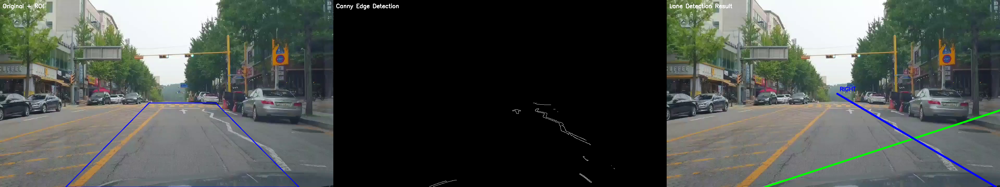

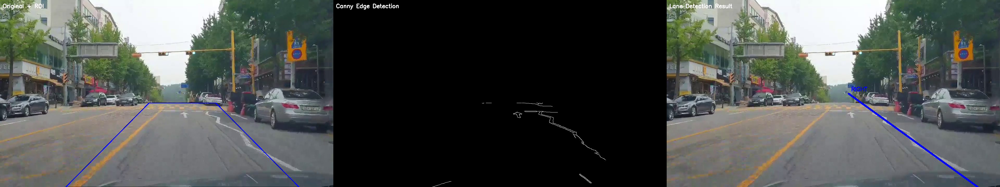

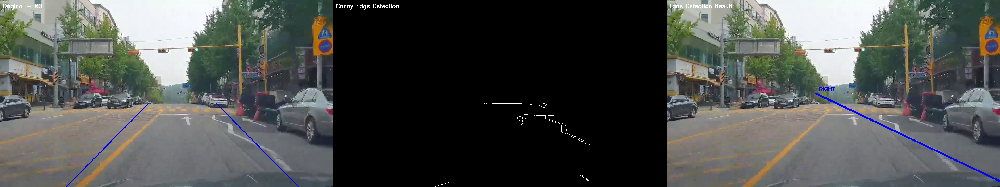

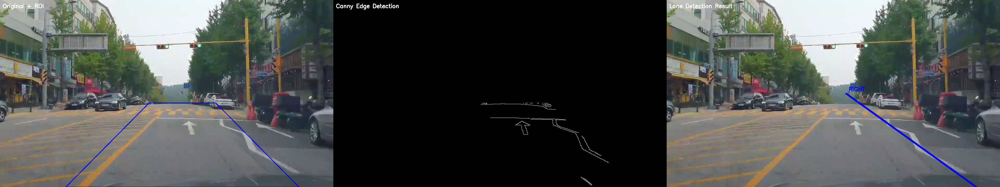

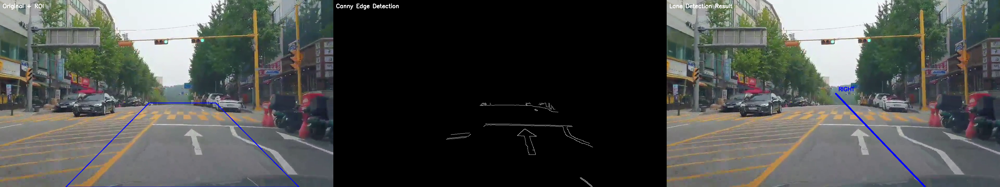

...

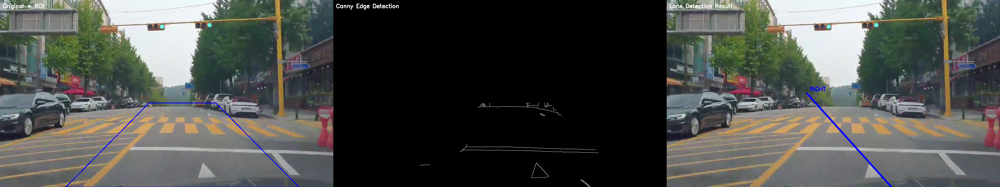

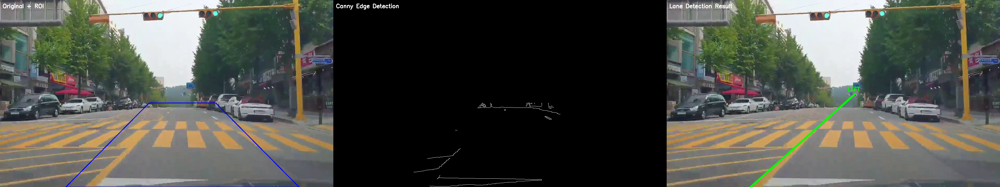

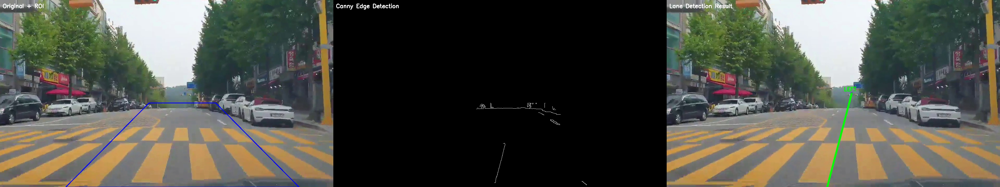

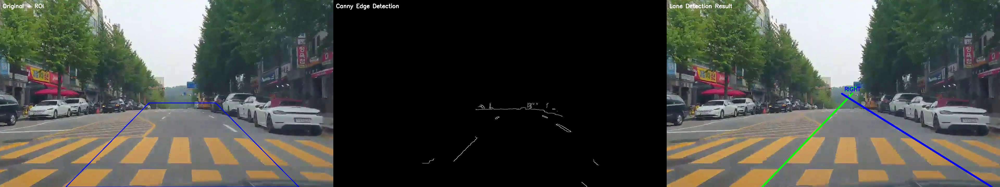

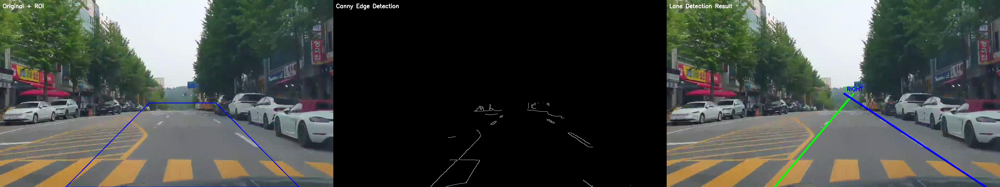

차선 검출 처리 완료!


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# 동영상 파일 열기
cap = cv2.VideoCapture('/content/sample_data/around5.mp4')  # 경로 확인 필요

# ROI 생성 함수
def create_lane_roi(frame):
    height, width = frame.shape[:2]
    mask = np.zeros((height, width), dtype=np.uint8)

    shift = 60  # ▶ 오른쪽으로 이동할 픽셀 수

    roi_points = np.array([
        [int(width * 0.15) + shift, height],                 # 왼쪽 아래
        [int(width * 0.40) + shift, int(height * 0.55)],     # 왼쪽 위
        [int(width * 0.60) + shift, int(height * 0.55)],     # 오른쪽 위
        [int(width * 0.85) + shift, height]                  # 오른쪽 아래
    ], np.int32)

    cv2.fillPoly(mask, [roi_points], 255)
    return mask, roi_points

# 프레임 처리 루프
frame_count = 0
while True:
    ret, frame = cap.read()
    if not ret:
        break

    # 그레이스케일 변환
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # 가우시안 블러
    blur = cv2.GaussianBlur(gray, (5, 5), 0)

    # Canny 엣지 검출
    edges = cv2.Canny(blur, 50, 150)

    # ROI 적용
    roi_mask, roi_points = create_lane_roi(frame)
    masked_edges = cv2.bitwise_and(edges, roi_mask)

    # Hough 변환
    lines = cv2.HoughLinesP(masked_edges, 1, np.pi/180, threshold=50,
                            minLineLength=50, maxLineGap=50)

    # 결과 프레임 준비
    result_frame = frame.copy()
    lane_frame = frame.copy()

    # ROI 시각화 (파란색 사다리꼴)
    cv2.polylines(result_frame, [roi_points], True, (255, 0, 0), 2)

    # 차선 분류
    left_lines = []
    right_lines = []
    if lines is not None:
        img_center = frame.shape[1] // 2

        for line in lines:
            x1, y1, x2, y2 = line[0]
            if x2 - x1 == 0:
                continue  # 수직선 제거
            slope = (y2 - y1) / (x2 - x1)

            if slope < -0.3 and x1 < img_center:
                left_lines.append([x1, y1, x2, y2])
            elif slope > 0.3 and x1 > img_center:
                right_lines.append([x1, y1, x2, y2])

    # 차선 연결 함수
    def connect_lane_segments(lines, frame_height):
        if not lines:
            return None
        points = []
        for x1, y1, x2, y2 in lines:
            points.extend([(x1, y1), (x2, y2)])
        if len(points) < 2:
            return None
        points = np.array(points)
        x_coords = points[:, 0]
        y_coords = points[:, 1]
        coeffs = np.polyfit(y_coords, x_coords, 1)
        y_top = frame_height // 2
        y_bottom = frame_height
        x_top = int(coeffs[0] * y_top + coeffs[1])
        x_bottom = int(coeffs[0] * y_bottom + coeffs[1])
        return [x_top, y_top, x_bottom, y_bottom]

    # 차선 연결
    left_lane = connect_lane_segments(left_lines, frame.shape[0])
    right_lane = connect_lane_segments(right_lines, frame.shape[0])

    if left_lane:
        cv2.line(lane_frame, (left_lane[0], left_lane[1]),
                 (left_lane[2], left_lane[3]), (0, 255, 0), 5)
        cv2.putText(lane_frame, "LEFT", (left_lane[0]-30, left_lane[1]-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)

    if right_lane:
        cv2.line(lane_frame, (right_lane[0], right_lane[1]),
                 (right_lane[2], right_lane[3]), (255, 0, 0), 5)
        cv2.putText(lane_frame, "RIGHT", (right_lane[0]+10, right_lane[1]-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 0, 0), 2)

    # 매 10프레임마다 결과 출력
    if frame_count % 10 == 0:
        cv2.putText(result_frame, "Original + ROI", (10, 30),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 255, 255), 2)

        edge_display = cv2.cvtColor(masked_edges, cv2.COLOR_GRAY2BGR)
        cv2.putText(edge_display, "Canny Edge Detection", (10, 30),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 255, 255), 2)

        cv2.putText(lane_frame, "Lane Detection Result", (10, 30),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 255, 255), 2)

        # 화면 합치기
        combined = np.hstack((result_frame, edge_display, lane_frame))
        cv2_imshow(combined)

    frame_count += 1
    if frame_count > 100:
        break

# 자원 해제
cap.release()
print("차선 검출 처리 완료!")
